# Computer Vision Project -  Object Detection

- 학습 내용
    - 프로젝트 1 : Image Classification
        - VGG16 모델을 구현하여 Image Classification task를 진행하고 다양한 방법을 사용하여 모델의 성능 올려봅시다.
    - 프로젝트 2 : Object Detection
        - RCNN 계열의 모델들을 알아보고 object detection 모델의 코드를 살펴보고 object detection task를 실제로 진행해 봅시다.
        
- 학습 목표
    - Image classification을 위한 모델의 코드를 이해하고, 스스로 새로운 모델을 만들어서 분류 성능을 높일 수 있습니다.
    - Pre-trained object detection 모델의 코드를 활용하여 object detection을 실제로 구현할 수 있습니다.

## Faster RCNN
- 논문: [Faster R-CNN: Towards Real-Time Object Detection with Region Proposal Networks](https://arxiv.org/pdf/1506.01497.pdf)

**RCNN vs Fast R-CNN vs Faster R-CNN**
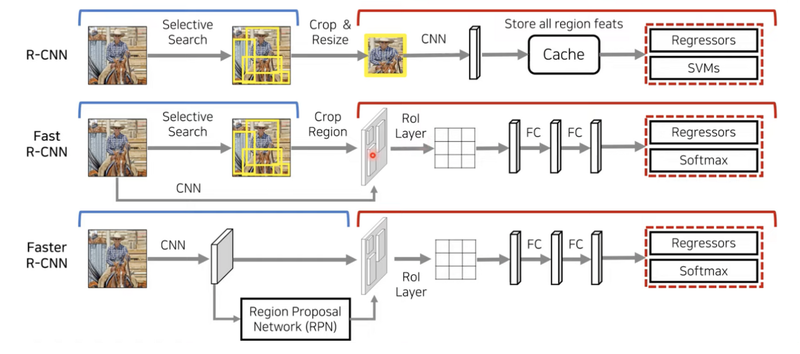

**Faster RCNN의 구조**
- RCNN, Fast RCNN과 Faster RCNN의 가장 큰 차이점은 Selective Search를 Region Proposal Network(RPN) 로 바꾸었다는 것이다.
- RPN은 RoI가 될 후보군인 Anchor Box를 무수히 만든다.
    - 그 후 Bounding Box Regression를 통해서 괜찮은 RoI를 딥러닝을 통해 학습하고 Classification을 통해 그것이 Object인지 아닌지를 판단한다.
- RPN을 통해 얻은 결과에 Object Classification을 통해서 해당 RoI에 있는 Object가 어떤 Class인지 구분하고, Bounding Box Regression을 실행한다.

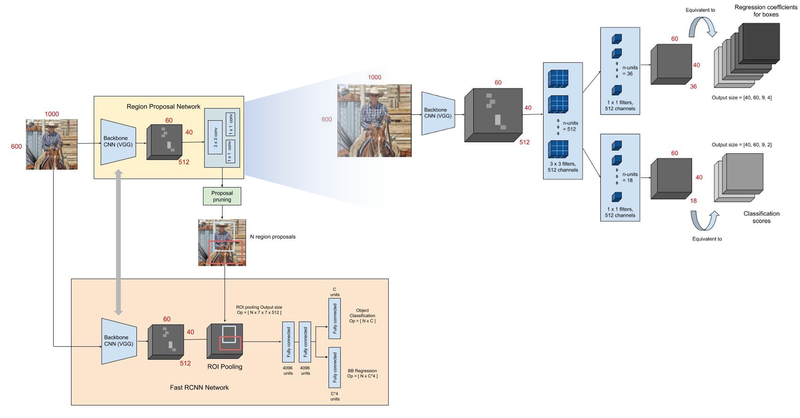

### 라이브러리 불러오기

In [1]:
!pip3 install tensorflow-estimator==2.6.0

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 462.9/462.9 kB 5.4 MB/s eta 0:00:00
  Attempting uninstall: tensorflow-estimator
    Found existing installation: tensorflow-estimator 2.15.0
    Uninstalling tensorflow-estimator-2.15.0:
      Successfully uninstalled tensorflow-estimator-2.15.0
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
tensorflow 2.15.0 requires tensorflow-estimator<2.16,>=2.15.0, but you have tensorflow-estimator 2.6.0 which is incompatible.


In [2]:
# Tensorflow와 Tensoflow Hub에 있는 이미 학습된 모델을 활용하기 위한 모듈
import tensorflow as tf
import tensorflow_hub as hub

# 이미지를 다운로드하는 데에 사용하는 모듈
import matplotlib.pyplot as plt
import tempfile
from six.moves.urllib.request import urlopen
from six import BytesIO

# 이미지에 선과 폰트를 넣기 위한 모듈
import numpy as np
from PIL import Image
from PIL import ImageColor
from PIL import ImageDraw
from PIL import ImageFont
from PIL import ImageOps

# Detection하는 데에 소요된 시간을 점검하기 위한 모듈
import time

### 이미지 시각화 함수

In [3]:
def display_image(image):
  fig = plt.figure(figsize=(20, 15))
  plt.grid(False)
  plt.imshow(image)

### 이미지 resizing 함수
이미지를 다운로드하고 정해진 가로, 세로 길이에 맞게 이미지를 resizing

In [4]:
def download_and_resize_image(url, new_width=256, new_height=256, display=False):

  _, filename = tempfile.mkstemp(suffix=".jpg")
  response = urlopen(url)
  image_data = response.read()
  image_data = BytesIO(image_data)  # 이미지 읽기
  pil_image = Image.open(image_data)
  pil_image = ImageOps.fit(pil_image, (new_width, new_height), Image.ANTIALIAS) # 이미지 조정
  pil_image_rgb = pil_image.convert("RGB") #RBG로 변환
  pil_image_rgb.save(filename, format="JPEG", quality=90) # 이미지 저장
  print("Image downloaded to %s." % filename)
  if display:
    display_image(pil_image)
  return filename

### Bounding Box 함수

In [5]:
def draw_bounding_box_on_image(image,
                               ymin, xmin, ymax, xmax,
                               color,
                               font,
                               thickness=4,
                               display_str_list=()):

  draw = ImageDraw.Draw(image)
  im_width, im_height = image.size
  (left, right, top, bottom) = (xmin * im_width, xmax * im_width,
                                ymin * im_height, ymax * im_height)

# BBox 테두리 그리기
  draw.line([(left, top), (left, bottom), (right, bottom), (right, top),
             (left, top)],
            width=thickness,
            fill=color)

  display_str_heights = [font.getsize(ds)[1] for ds in display_str_list]

  total_display_str_height = (1 + 2 * 0.05) * sum(display_str_heights)

  if top > total_display_str_height:
    text_bottom = top
  else:
    text_bottom = top + total_display_str_height

  for display_str in display_str_list[::-1]:
    text_width, text_height = font.getsize(display_str)
    margin = np.ceil(0.05 * text_height)
    draw.rectangle([(left, text_bottom - text_height - 2 * margin),
                    (left + text_width, text_bottom)],
                   fill=color)
    draw.text((left + margin, text_bottom - text_height - margin),
              display_str,
              fill="black",
              font=font)
    text_bottom -= text_height - 2 * margin

### 이미지 위에 class 이름과 score를 나타내는 함수

In [6]:
# BBox 그리기
def draw_boxes(image, boxes, class_names, scores, max_boxes=10, min_score=0.1):
  colors = list(ImageColor.colormap.values())

  try:
    font = ImageFont.truetype("/usr/share/fonts/truetype/liberation/LiberationSansNarrow-Regular.ttf",
                              25)
  except IOError:
    print("Font not found, using default font.")
    font = ImageFont.load_default()

# BBox 그리기 적용
  for i in range(min(boxes.shape[0], max_boxes)):
    if scores[i] >= min_score:
      ymin, xmin, ymax, xmax = tuple(boxes[i])  # 박스 좌표값
      display_str = "{}: {}%".format(class_names[i].decode("ascii"),
                                     int(100 * scores[i]))
      color = colors[hash(class_names[i]) % len(colors)]
      image_pil = Image.fromarray(np.uint8(image)).convert("RGB")
      draw_bounding_box_on_image(
          image_pil,
          ymin,
          xmin,
          ymax,
          xmax,
          color,
          font,
          display_str_list=[display_str])
      np.copyto(image, np.array(image_pil))
  return image

## 이미지 불러오기

<ipython-input-4-aa2905205e73>:8: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  pil_image = ImageOps.fit(pil_image, (new_width, new_height), Image.ANTIALIAS) # 이미지 조정


Image downloaded to /tmp/tmp3p1labt2.jpg.


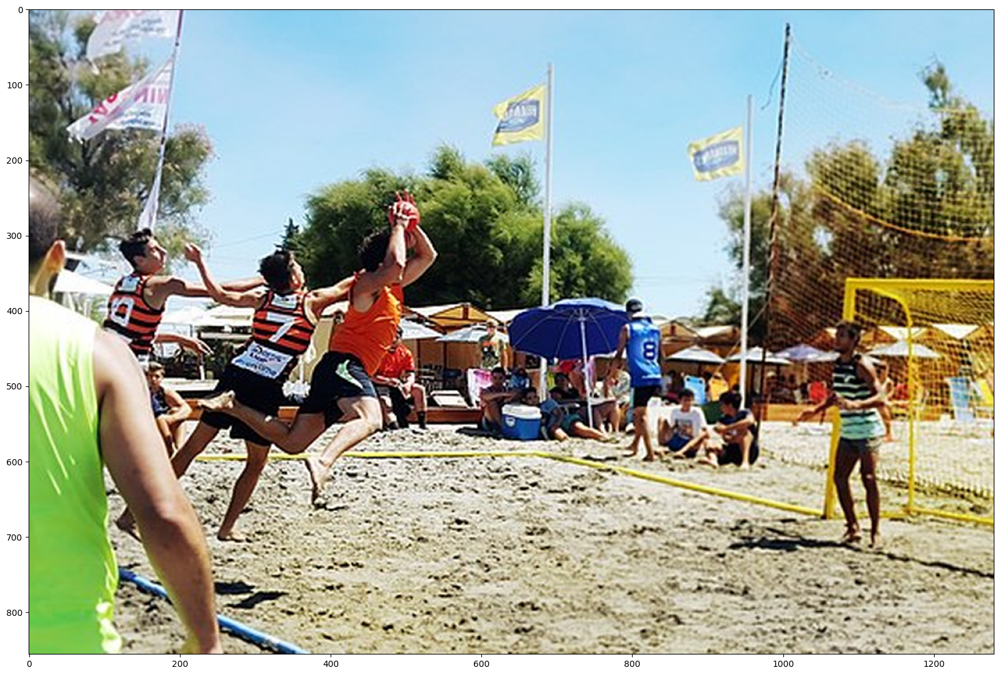

In [7]:
image_url = "https://upload.wikimedia.org/wikipedia/commons/thumb/d/db/Torneo_beach_handball.jpg/640px-Torneo_beach_handball.jpg"
downloaded_image_path = download_and_resize_image(image_url, 1280, 856, True)

## Faster RCNN 모델을 불러오기
[tfhub](https://www.kaggle.com/models?tfhub-redirect=true)에서 사전 학습된(Pre-trained) [InceptionResnet](https://arxiv.org/pdf/1602.07261v2.pdf) 모델을 사용

In [8]:
module_handle = "https://tfhub.dev/google/faster_rcnn/openimages_v4/inception_resnet_v2/1"

detector = hub.load(module_handle).signatures['default'] # detector에 사용할 모듈 저장

In [9]:
def load_img(path):
  img = tf.io.read_file(path)
  img = tf.image.decode_jpeg(img, channels=3)
  return img

### Detector 실행하는 함수

In [10]:
def run_detector(detector, path):
  img = load_img(path)

  converted_img  = tf.image.convert_image_dtype(img, tf.float32)[tf.newaxis, ...]

# 소요시간 측정
  start_time = time.time()
  result = detector(converted_img)
  end_time = time.time()

  result = {key:value.numpy() for key,value in result.items()}

# 이미지 추론 개수와 추론 시간 출력
  print("Found %d objects." % len(result["detection_scores"]))
  print("Inference time: ", end_time-start_time)

# 이미지 내 박스로 entity, scores를 추가하여 출력
  image_with_boxes = draw_boxes(
      img.numpy(), result["detection_boxes"],
      result["detection_class_entities"], result["detection_scores"])

  display_image(image_with_boxes)

Found 100 objects.
Inference time:  52.939149141311646


<ipython-input-5-8b156eaed91c>:19: DeprecationWarning: getsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use getbbox or getlength instead.
  display_str_heights = [font.getsize(ds)[1] for ds in display_str_list]
<ipython-input-5-8b156eaed91c>:29: DeprecationWarning: getsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use getbbox or getlength instead.
  text_width, text_height = font.getsize(display_str)


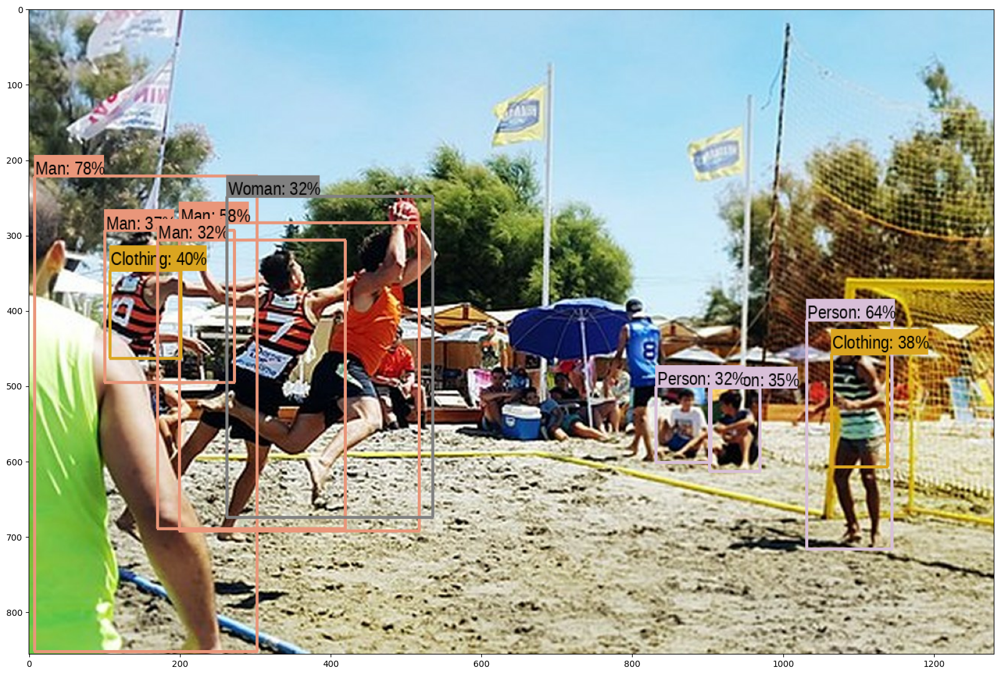

In [11]:
# detector 실행
run_detector(detector, downloaded_image_path)

## 다른 이미지 테스트

### 이미지 불러오기

<ipython-input-4-aa2905205e73>:8: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  pil_image = ImageOps.fit(pil_image, (new_width, new_height), Image.ANTIALIAS) # 이미지 조정


Image downloaded to /tmp/tmphtwsik_7.jpg.


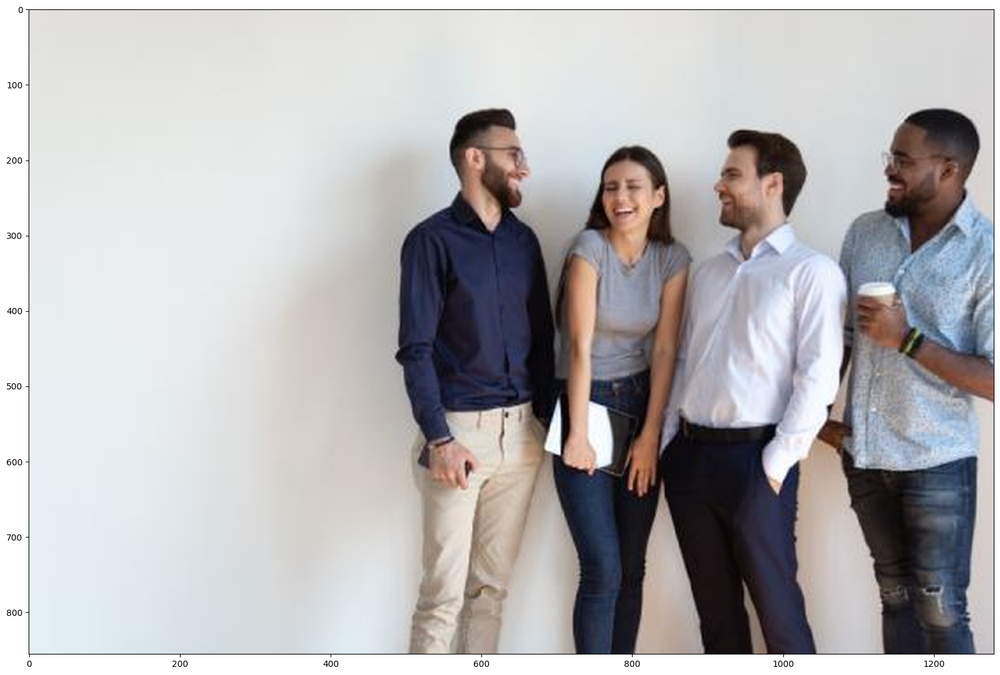

In [12]:
# "https://mindgil.com/editor/cheditor_5/attach/20210215115444_dbupiqux.jpg"

image_url = "https://mindgil.com/editor/cheditor_5/attach/20210215115444_dbupiqux.jpg"
downloaded_image_path = download_and_resize_image(image_url, 1280, 856, True)  # new_width와 new_height를 변경해 보세요.

### 테스트

Found 100 objects.
Inference time:  1.2840685844421387


<ipython-input-5-8b156eaed91c>:19: DeprecationWarning: getsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use getbbox or getlength instead.
  display_str_heights = [font.getsize(ds)[1] for ds in display_str_list]
<ipython-input-5-8b156eaed91c>:29: DeprecationWarning: getsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use getbbox or getlength instead.
  text_width, text_height = font.getsize(display_str)


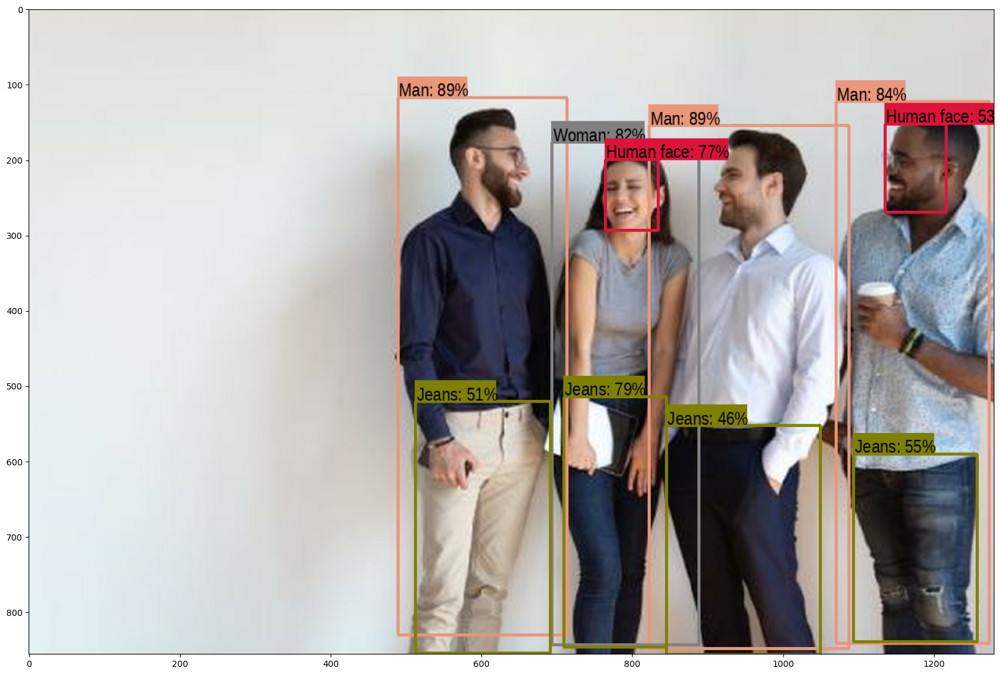

In [13]:
run_detector(detector, downloaded_image_path)

### 동물

<ipython-input-4-aa2905205e73>:8: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  pil_image = ImageOps.fit(pil_image, (new_width, new_height), Image.ANTIALIAS) # 이미지 조정


Image downloaded to /tmp/tmpikj3eihz.jpg.


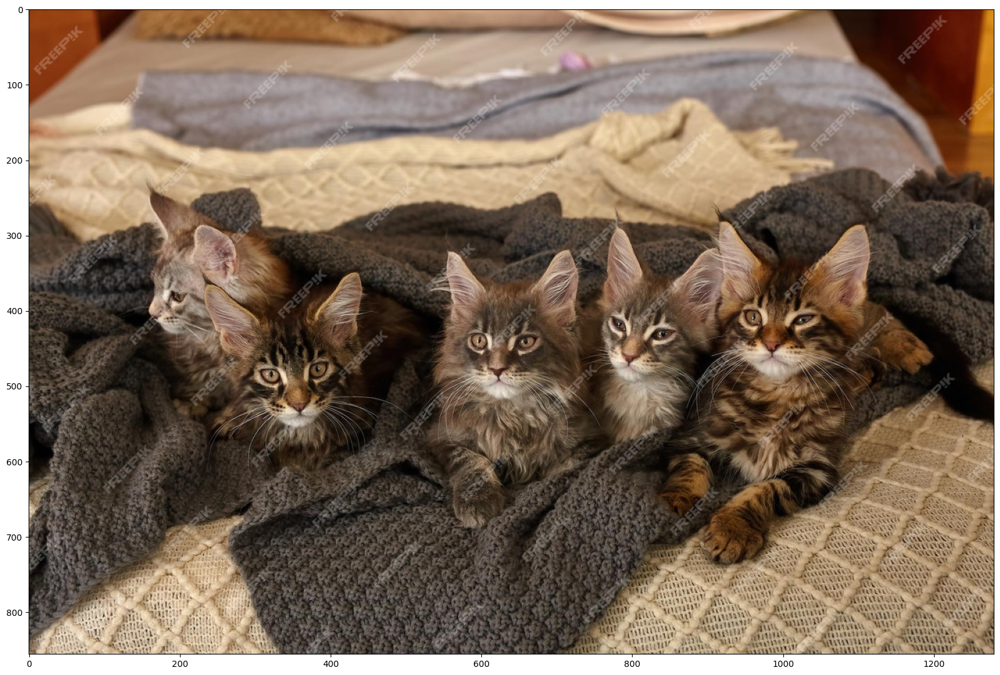

In [14]:
image_url = "https://img.freepik.com/premium-photo/group-of-6-cute-maine-coon-kittens-lying-in-grey-warm-blanket_114309-4943.jpg?w=1800"
downloaded_image_path = download_and_resize_image(image_url, 1280, 856, True)  # new_width와 new_height를 변경해 보세요.

Found 100 objects.
Inference time:  1.5379421710968018


<ipython-input-5-8b156eaed91c>:19: DeprecationWarning: getsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use getbbox or getlength instead.
  display_str_heights = [font.getsize(ds)[1] for ds in display_str_list]
<ipython-input-5-8b156eaed91c>:29: DeprecationWarning: getsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use getbbox or getlength instead.
  text_width, text_height = font.getsize(display_str)


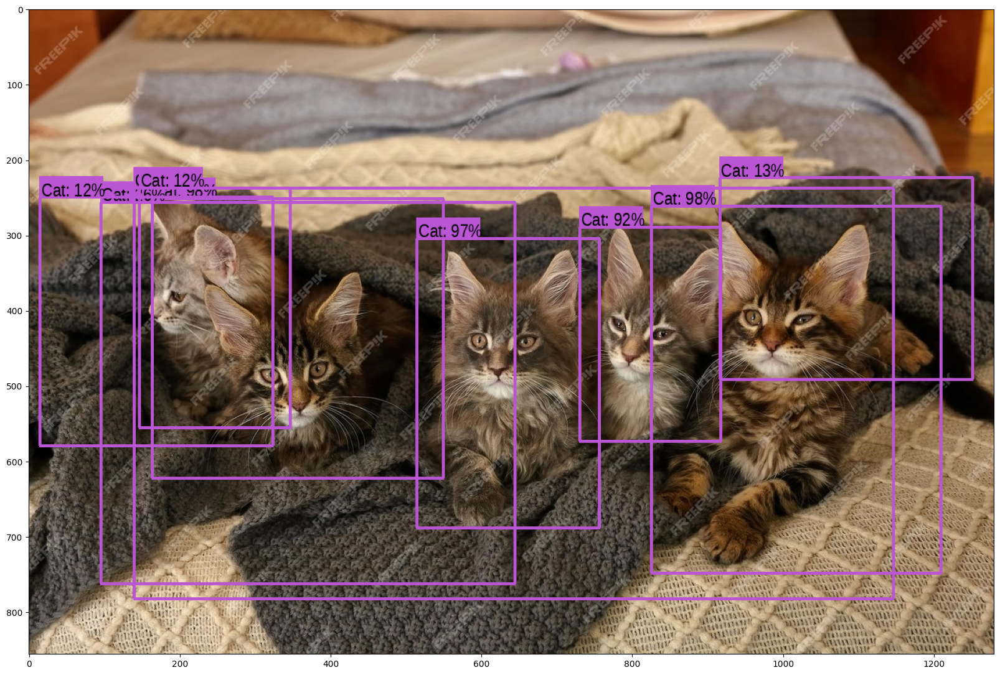

In [15]:
run_detector(detector, downloaded_image_path)

### 식물

<ipython-input-4-aa2905205e73>:8: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  pil_image = ImageOps.fit(pil_image, (new_width, new_height), Image.ANTIALIAS) # 이미지 조정


Image downloaded to /tmp/tmp7g5sr071.jpg.


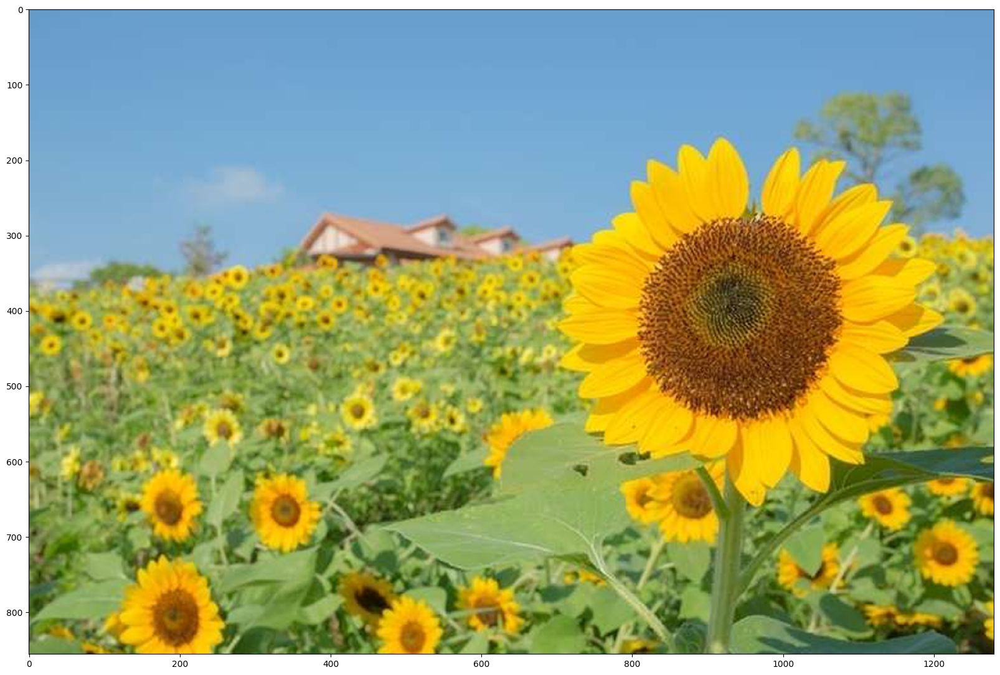

In [16]:
image_url = "https://rimage.gnst.jp/livejapan.com/public/article/detail/a/20/00/a2000650/img/basic/a2000650_main.jpg?20230509000000&q=80"
downloaded_image_path = download_and_resize_image(image_url, 1280, 856, True)  # new_width와 new_height를 변경해 보세요.

Found 100 objects.
Inference time:  1.2732560634613037


<ipython-input-5-8b156eaed91c>:19: DeprecationWarning: getsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use getbbox or getlength instead.
  display_str_heights = [font.getsize(ds)[1] for ds in display_str_list]
<ipython-input-5-8b156eaed91c>:29: DeprecationWarning: getsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use getbbox or getlength instead.
  text_width, text_height = font.getsize(display_str)


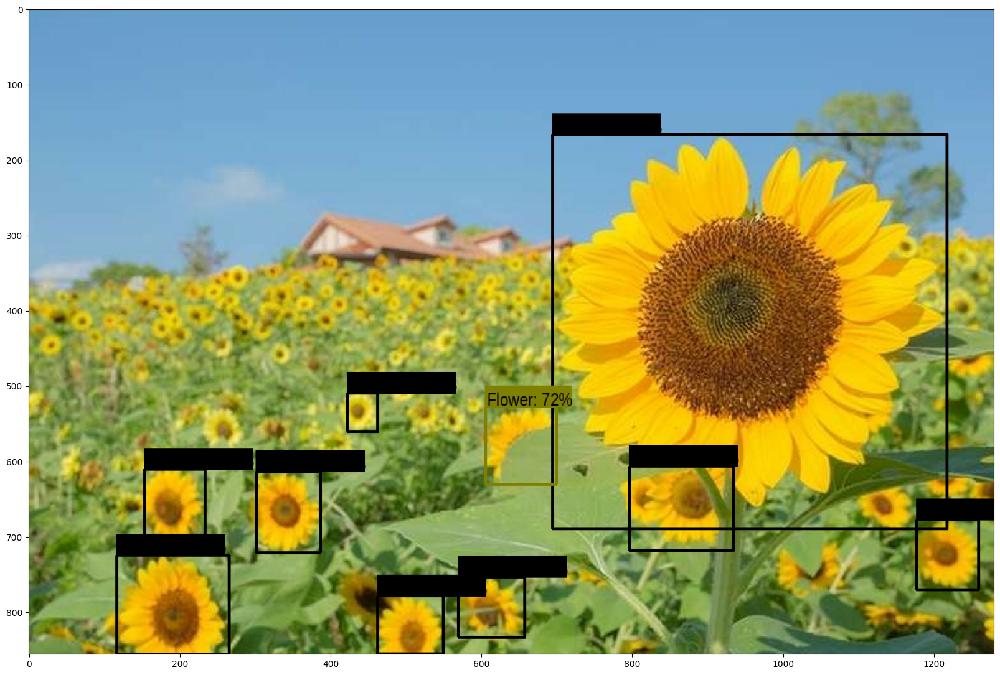

In [17]:
run_detector(detector, downloaded_image_path)

## 다양한 pre-trained model 테스트
Faster RCNN 외에도 Object Detection을 할 수 있는 다양한 사전 학습 모델이 있다.   
tfhub을 탐색하여 사용할 수 있는 1개 이상의 모델을 불러와 결과를 테스트해보고, 그 결과를 비교해 보시오.

### SSD

#### 모델 불러오기

In [20]:
# SSD 모델 불러오기
ssd_module_handle = "https://tfhub.dev/google/openimages_v4/ssd/mobilenet_v2/1"
ssd_detector = hub.load(ssd_module_handle).signatures['default']

#### 테스트

<ipython-input-4-aa2905205e73>:8: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  pil_image = ImageOps.fit(pil_image, (new_width, new_height), Image.ANTIALIAS) # 이미지 조정


Image downloaded to /tmp/tmpnx_17qbc.jpg.


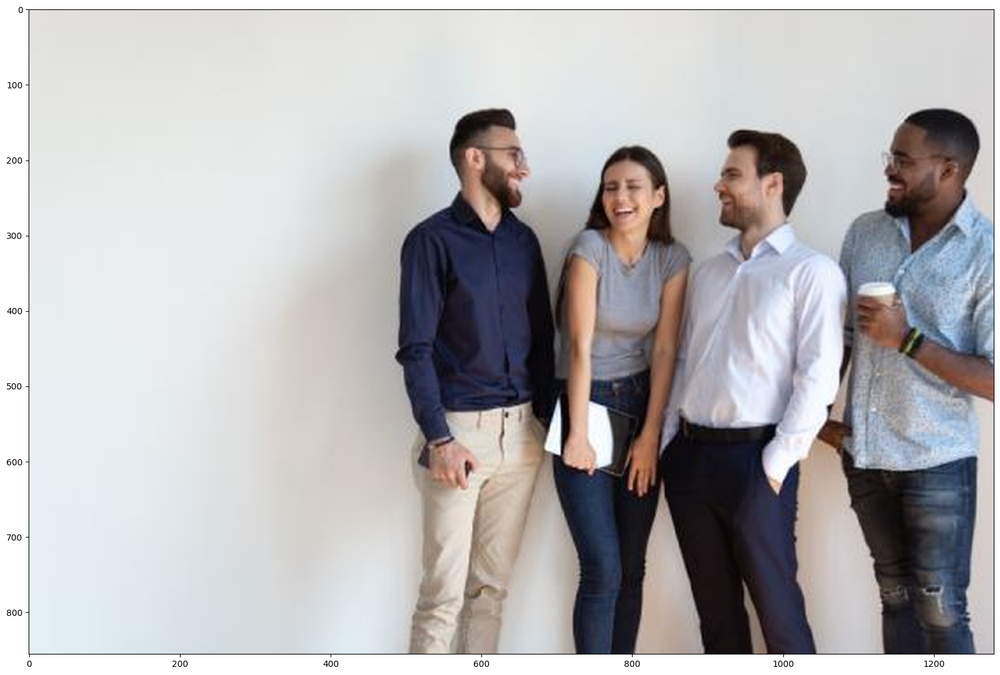

In [22]:
# "https://mindgil.com/editor/cheditor_5/attach/20210215115444_dbupiqux.jpg"

image_url = "https://mindgil.com/editor/cheditor_5/attach/20210215115444_dbupiqux.jpg"
downloaded_image_path = download_and_resize_image(image_url, 1280, 856, True)  # new_width와 new_height를 변경해 보세요.

Found 100 objects.
Inference time:  0.25751352310180664


<ipython-input-5-8b156eaed91c>:19: DeprecationWarning: getsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use getbbox or getlength instead.
  display_str_heights = [font.getsize(ds)[1] for ds in display_str_list]
<ipython-input-5-8b156eaed91c>:29: DeprecationWarning: getsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use getbbox or getlength instead.
  text_width, text_height = font.getsize(display_str)


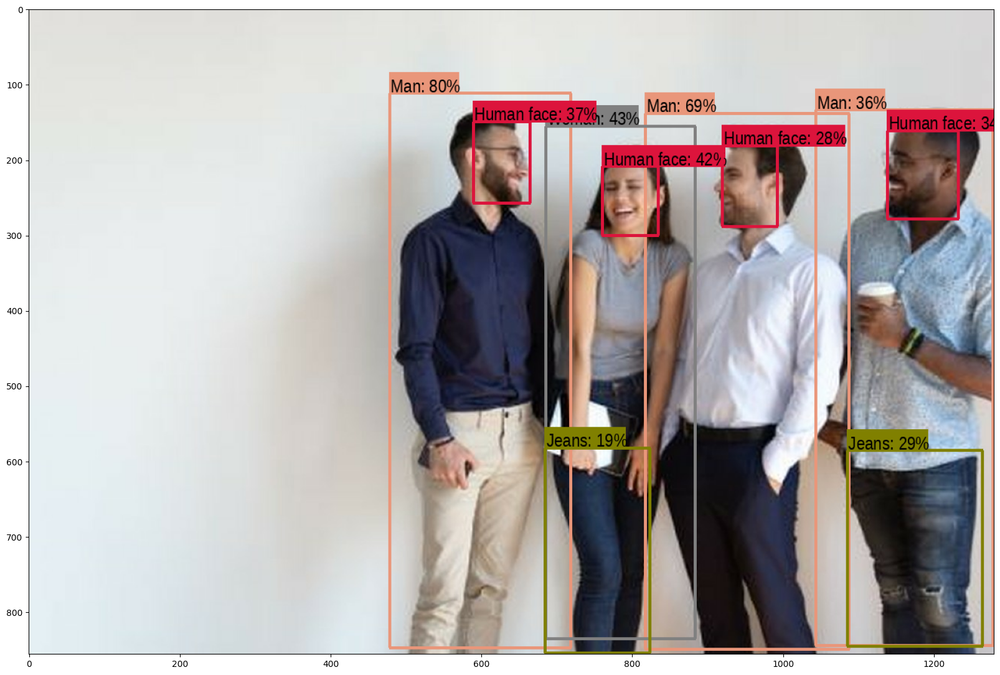

In [23]:
run_detector(ssd_detector, downloaded_image_path)

### 결과 비교

**Faster R-CNN**
- 감지된 바운딩 박스들이 더 정확하게 대상을 감싸고 있다.
- 여러 객체를 식별하고 높은 신뢰도 점수로 분류를 제공하고 있다.
  - 예를 들어 "Man"과 "Jeans"와 같은 분류들이 높은 신뢰도를 보여준다.
- 얼굴도 비교적 높은 신뢰도로 탐지되었으며, 이미지 내에서 특징을 잘 지역화하고 있음을 나타낸다.
- 모델은 이미지 속 인물의 성별을 높은 신뢰도로 구분하고 있다.
<br/>
<br/>

**SSD**
- 바운딩 박스들이 Faster R-CNN보다 덜 정확하며, 몇몇 박스는 대상을 덜 정확하게 감싸고 있다.
- 객체에 대한 신뢰도 점수가 Faster R-CNN에 비해 전반적으로 낮다.
- "Human face"와 같은 일부 탐지는 훨씬 낮은 신뢰도를 보이며, 이는 특징 인식의 정밀도가 덜하다는 것을 의미할 수 있다.
- "Jeans" 주위의 바운딩 박스는 신뢰도가 눈에 띄게 낮으며, Faster R-CNN만큼 정확하게 전체 영역을 포함하지 않는다.
<br/>
<br/>

**종합적인 관찰**
- Faster R-CNN은 더 정확한 객체 위치 파악과 높은 신뢰도의 탐지 결과를 제공한다.
  - 이 모델은 높은 정확도로 잘 알려져 있지만, 속도 측면에서는 느릴 수 있다.
- SSD는 실시간 응용 프로그램에서 유용할 수 있는 더 빠른 탐지 시간을 제공한다.
  - 비록 탐지 정확도와 신뢰도 점수에서는 약간의 타협이 있을 수 있다.

정확도가 속도보다 더 중요한 응용 프로그램에서는 Faster R-CNN이 선호될 수 있다.   
반대로, 실시간 탐지가 필요하고 속도가 중요한 경우에는 정확도가 약간 떨어짐에도 불구하고 SSD가 더 적합할 수 있다.